# GUC NETW 1003 Kmeans Assginmnet 

Objective: exercise is to learn how to use build and use  kmeans clustering algortrithm    

At the end of this lab you will be able to
> 1. Build and run a K-means algorithm.
> 2. Know how to evalute K-means Algorithm 
> 2. Understand the effect of the parmeters ont he perfromance of the algorithm .
> 3. Understand the effect of distance.

## 1. Wirte K means function 

import required libraries 

In [2]:
import numpy as np, pandas as pd, seaborn as sns, matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from sklearn.datasets import make_moons

In [24]:
# points = [[3, 6, 2], [1, 5, 7], [7, 2, 1]]
# points = np.array(points)


> ### 1.1. Code for the distance function 

write a function to calculate the distance between a set of cluster centroids and all the data points 

Cluster_Distances = GUC_Distance ( Cluster_Centroids, Data_points, Distance_Type) 
* The function shoud be able to handel data points with any number of features and any number of points 
* The function should be able to handle any K number of cluster centroids 
* To inrease speed do that in matrix format using numpy
* This should produce a matrix with rows equal to data points columns equal K 
* You should be able to calculate different types of Distance. In this assginmnet you are required to implement the following two 
    - Ecluidian distance
    - Pearson correlation distance
  

In [28]:
def GUC_Distance ( Cluster_Centroids, Data_points, Distance_Type ):
    
    if Distance_Type == "Euclidean" :
        
        Cluster_Distance = np.sqrt(np.sum((Data_points[:, np.newaxis, :] - Cluster_Centroids) ** 2, axis=2))
        
    elif Distance_Type == "Pearson":
        
        num_centroids, _ = Cluster_Centroids.shape
        num_points, num_features = Data_points.shape
        
        # Initialize a matrix to store the correlation distances
        Cluster_Distance = np.zeros((num_points, num_centroids))

        # Compute Pearson correlation distance for each centroid and data point pair
        for c in range(num_centroids):
            for p in range(num_points):
                # Compute Pearson correlation coefficient
                centroid_mean = np.mean(Cluster_Centroids[c])
                data_mean = np.mean(Data_points[p])
                covariance = np.sum((Cluster_Centroids[c] - centroid_mean) * (Data_points[p] - data_mean))
                centroid_std = np.sqrt(np.sum((Cluster_Centroids[c] - centroid_mean) ** 2))
                data_std = np.sqrt(np.sum((Data_points[p] - data_mean) ** 2))

                # Handle division by zero error
                if centroid_std * data_std == 0:
                    Cluster_Distance[p, c] = np.nan
                else:
                    Cluster_Distance[p, c] = 1 - (covariance / (centroid_std * data_std))
        
        
        
    
    return Cluster_Distance 


> ### 1.2. Code for K means function 

> Loop until a stopping condition 

> > in the loop do the following 
> > 1. Cluster Assginmnet 
> > > * Use the GUC_Distance to calculate between each cluster head and all the points 
> > > * Find the value and index of the minimum distance  for each row. 
> > > * for each point in the row use the index of the minmum distance to represent the cluster Centroid that this point will belong to.
> > > * Calculate and record the mean square distance for each cluster  
> > > * Use the mean square distances to calculate a stopping condition (e.g the sum of mean distances)
> > 2. Updtate Centroids  
> > > * Update the value for the cluster heads by calculating the mean value for the points in each cluster 
> > >  * Calculate the Cluster Metric (Distortion Function)
> > > > a number indicating the how good the clusters are . An example cluster metric is the  (sum of squared error between each point and its cluster center) 

In [43]:
def GUC_Kmean ( Data_points, Number_of_Clusters,  Distance_Type ):
        
       
        min_values = Data_points.min(axis=0)
        max_values = Data_points.max(axis=0)
            
        num_dimensions = Data_points.shape[1]
        Cluster_Centroids = np.empty((Number_of_Clusters, num_dimensions))

        for i in range(num_dimensions):
            Cluster_Centroids[:, i] = np.random.uniform(min_values[i], max_values[i], size=Number_of_Clusters)
        
        prev_msd = 0
        while True:
            distances = GUC_Distance(Cluster_Centroids, Data_points, Distance_Type)
            min_values = np.nanmin(distances, axis=1)
            min_indices = np.nanargmin(distances, axis=1)
            
            total_distance = 0
            MSD = np.zeros((1, Number_of_Clusters), dtype=float)
            new_cluster = np.zeros((Number_of_Clusters, num_dimensions), dtype=float)
            for index in range(len(Data_points)):
                row = Data_points[index]
                point = np.array(Data_points[index])
                cluster = min_indices[index]
                centroid = Cluster_Centroids[cluster, :]
                new_cluster[cluster, :] = new_cluster[cluster, :] + point
                dist = np.linalg.norm(point - centroid) ** 2
                MSD[0][cluster] = MSD[0][cluster] + dist
            tolerance = 1e-2
            if np.abs(np.sum(MSD) - prev_msd) <= tolerance:
                break
            prev_msd = np.sum(MSD)
            for i in range(Number_of_Clusters):
                count = np.count_nonzero(min_indices == i)
                if count != 0:
                    MSD[0][i] = MSD[0][i] / count
                    new_cluster[i] = new_cluster[i] / count
            
            Cluster_Centroids = new_cluster
            sums = 0
            for i in range(Number_of_Clusters):
                belonging = Data_points[(min_indices == i).flatten()]
                if len(belonging) != 0:
                    sums += np.sum(np.square(belonging - Cluster_Centroids[i]))
            sums /= len(Data_points)

        Final_Cluster_Distance = kmeans_res(Cluster_Centroids, min_indices.flatten())
        Cluster_Metric = sums
        return [ Final_Cluster_Distance , Cluster_Metric ]    


In [80]:
n_samples = 1000
X, y = noisy_moons = make_moons(n_samples=n_samples, noise= .1)
GUC_Kmean(X, 2, "Euclidean")

[<__main__.kmeans_res at 0x1f7defe47d0>, 0.41318209929575767]

In [5]:
class kmeans_res:
    def __init__(self, centers, labels):
        self.labels_ = labels
        self.cluster_centers_ = centers

## 2. Display Results 

* below is a an example fuction that displayes Clusters in 2D 

* You need to change the function so that is can display an n dimension data in the form of pairs of subplot 2D figures 

* The function is a helper function that is originaly be found in 
https://www.coursera.org/learn/ibm-unsupervised-learning/


In [12]:
import numpy as np, pandas as pd, seaborn as sns, matplotlib.pyplot as plt, math

> #### 2.1. helper Display function 

In [13]:
# # helper function that allows us to display data in 2 dimensions an highlights the clusters
# def display_cluster(X,km=[],num_clusters=0):
#     color = ['b', 'r', 'g', 'c', 'm', 'y', 'k', "#93C572", "#FFA555", "#F1235A"]  #List colors
#     alpha = 0.5  #color obaque
#     s = 20
#     if num_clusters == 0:
#         plt.scatter(X[:,0],X[:,1],c = color[0],alpha = alpha,s = s)
#     else:
#         for i in range(num_clusters):
#             plt.scatter(X[km.labels_==i,0],X[km.labels_==i,1],c = color[i],alpha = alpha,s=s)
#             plt.scatter(km.cluster_centers_[i,0],km.cluster_centers_[i,1],c = color[i], marker = 'x', s = 100)

def display_cluster(X, km=None, num_clusters=0):
    color = ['b', 'r', 'g', 'c', 'm', 'y', 'k', "#93C572", "#FFA555", "#F1235A"]  # List of colors
    alpha = 0.5  # Opacity of the colors
    s = 20  # Size of points

    num_dimensions = X.shape[1]  # Number of dimensions in the dataset

    if num_dimensions < 2:
        print("Cannot display less than 2 dimensions.")
        return

    if num_dimensions == 2:
        if num_clusters == 0:
            plt.scatter(X[:, 0], X[:, 1], c=color[0], alpha=alpha, s=s)
        else:
            for i in range(num_clusters):
                plt.scatter(X[km.labels_ == i, 0], X[km.labels_ == i, 1], c=color[i], alpha=alpha, s=s)
                plt.scatter(km.cluster_centers_[i, 0], km.cluster_centers_[i, 1], c=color[i], marker='x', s=100)
        plt.xlabel('Dimension 1')
        plt.ylabel('Dimension 2')
        plt.title('Cluster Visualization')
        plt.show()
    else:
        subplot_size = (num_dimensions * ((num_dimensions + 1) / 2)) - num_dimensions
        fig, axs = plt.subplots(math.ceil(subplot_size / 2), 2, figsize=(80, 40))
        fig.subplots_adjust(hspace=0.5)
        
        dim = -1
        count = 0
        for k in range(num_dimensions):
            for j in range(k+1, num_dimensions):
                
                col = count%2
                if count%2 == 0:
                    dim += 1
                count += 1
                
                if num_clusters == 0:
                    axs[dim, col].scatter(X[:, k], X[:, j], c=color[0], alpha=alpha, s=s)
                else:
                    for i in range(num_clusters):
                        axs[dim, col].scatter(X[km.labels_ == i, k], X[km.labels_ == i, j],
                                              c=color[i], alpha=alpha, s=s)
                        axs[dim, col].scatter(km.cluster_centers_[i, k], km.cluster_centers_[i, j],
                                              c=color[i], marker='x', s=100)
                axs[dim, col].set_xlabel(f'Dimension {k+1}')
                axs[dim, col].set_ylabel(f'Dimension {j+1}')
                axs[dim, col].set_title(f'Cluster Visualization (Dimensions {k+1} and {j+1})')
                

        plt.show()


> #### 2.2. Example 1 : Circular Data Gen and display 

* below is an example of how to use the funciton 
  *  prepare the figure size and background 
   > * this part can be replaced by a number of subplots 
  
  * Produce a data set that represent the x and y o coordinates of a circle 
   > * this part can be replaced by data that you import froma file 
  
  * Data is displayed 
   > * to display the data only it is assumed that the number of clusters is zero which is the default of the fuction 

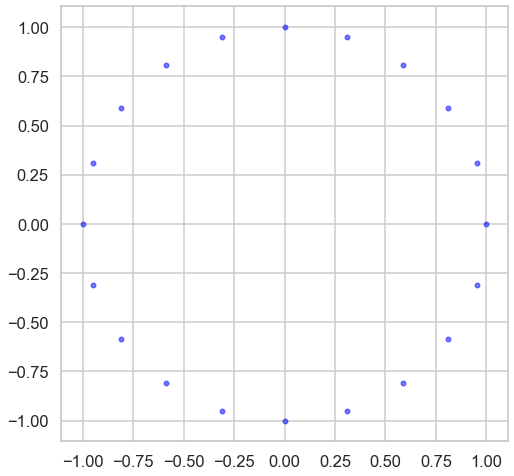

In [5]:
# prepare the figure sise and background 
# this part can be replaced by a number of subplots 
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")
# Produce a data set that represent the x and y o coordinates of a circle 
# this part can be replaced by data that you import froma file 
angle = np.linspace(0,2*np.pi,20, endpoint = False)
X = np.append([np.cos(angle)],[np.sin(angle)],0).transpose()
# Data is displayed 
# to display the data only it is assumed that the number of clusters is zero which is the default of the fuction 
display_cluster(X)

> #### 2.3. Example 2 : Multi blob Data Gen and display 

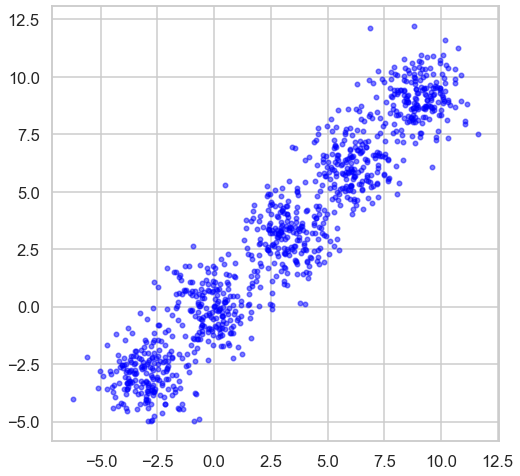

In [6]:
n_samples = 1000
n_bins = 4  
centers = [(-3, -3), (0, 0), (3, 3), (6, 6), (9,9)]
X, y = make_blobs(n_samples=n_samples, n_features=2, cluster_std=1.0,
                  centers=centers, shuffle=False, random_state=42)
display_cluster(X)

#### 2.3. Example 3 : moons Data Gen and display 

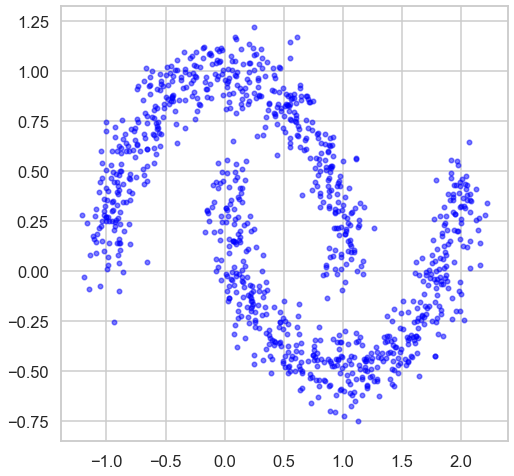

In [18]:
n_samples = 1000
X, y = noisy_moons = make_moons(n_samples=n_samples, noise= .1)
display_cluster(X)

## 3. Testing the GUC_Kmean function on Simple 2D
1. Apply the GUC_Kmean fucntion to 2D Data provided by example 1, Example 2 and Example 3
2. Try a varing number of cluster centriods that range from 2 to 10 clusters on each set 
3. Display your results.
4. plot the Cluster perfromance Metric versus the number of clusters
4. Change the distance function and repeat the above steps 

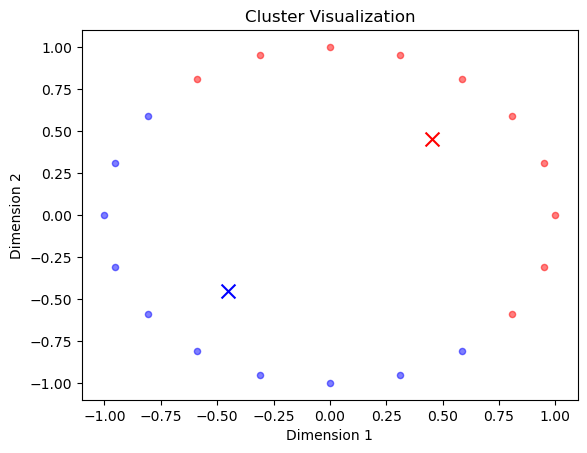

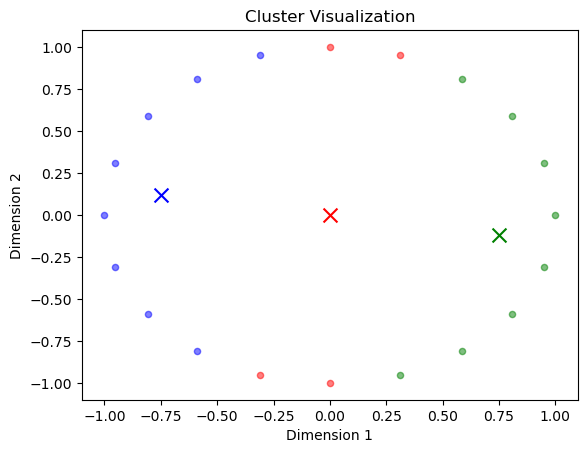

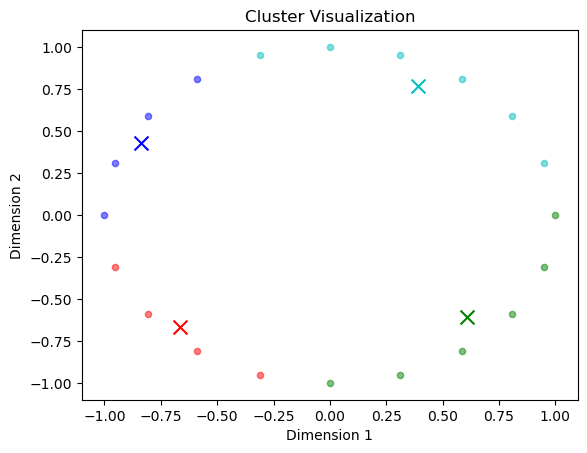

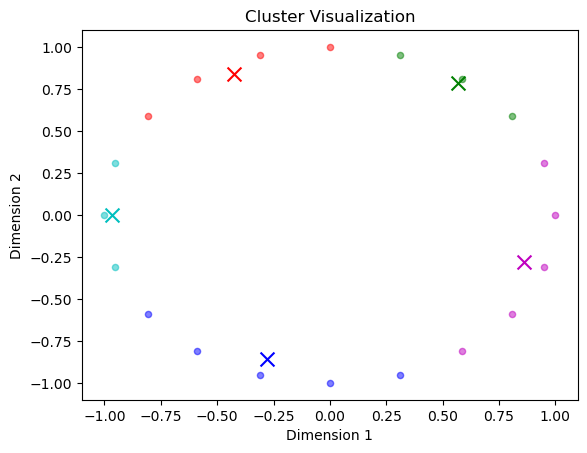

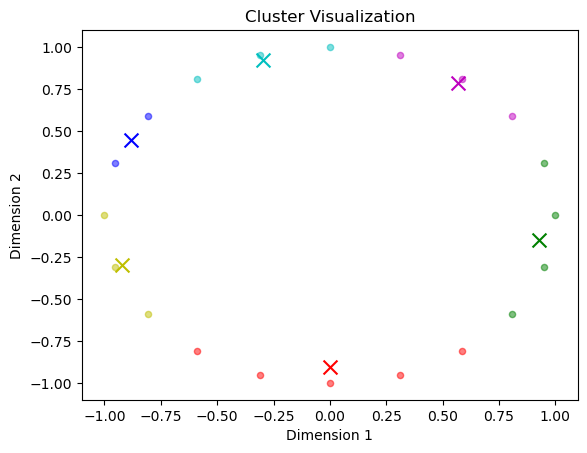

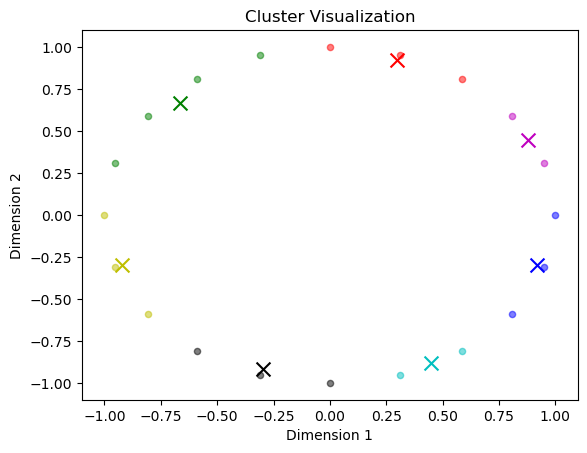

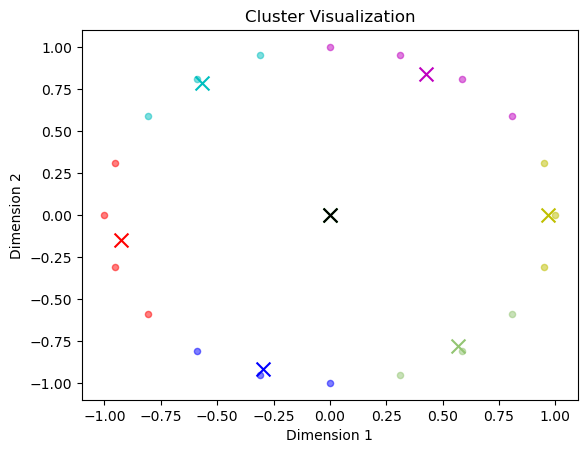

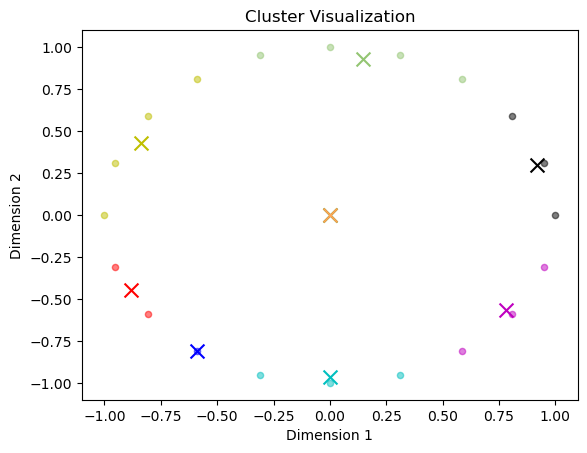

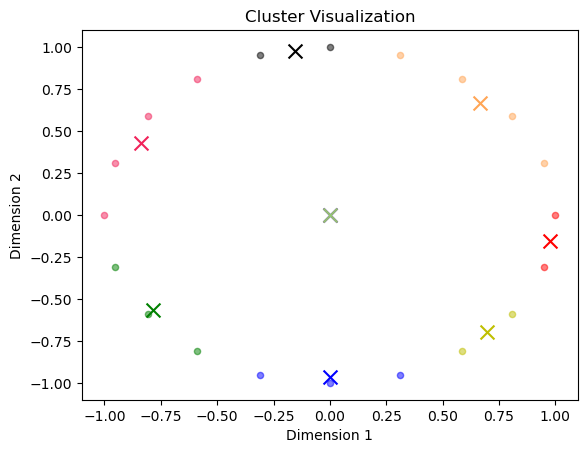

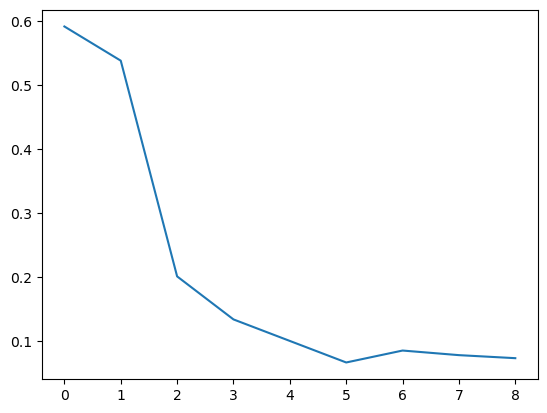

In [30]:
angle = np.linspace(0,2*np.pi,20, endpoint = False)
X = np.append([np.cos(angle)],[np.sin(angle)],0).transpose()
dist_func = []
for i in range(2, 11):
    y, z = GUC_Kmean(X, i, "Euclidean")
    dist_func.append(z)
    plt.figure()
    display_cluster(X, km=y,num_clusters=i)
    
plt.figure()
plt.plot(dist_func)

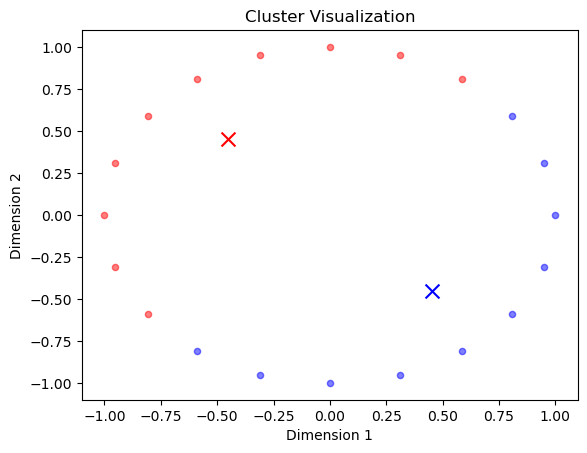

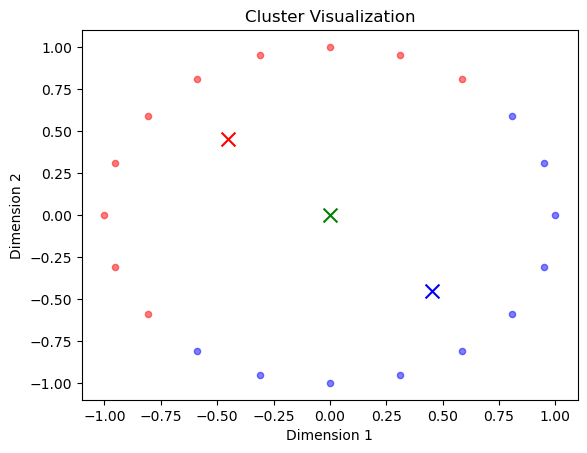

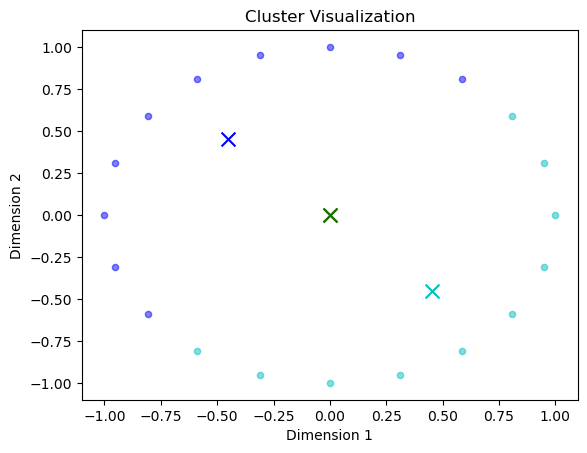

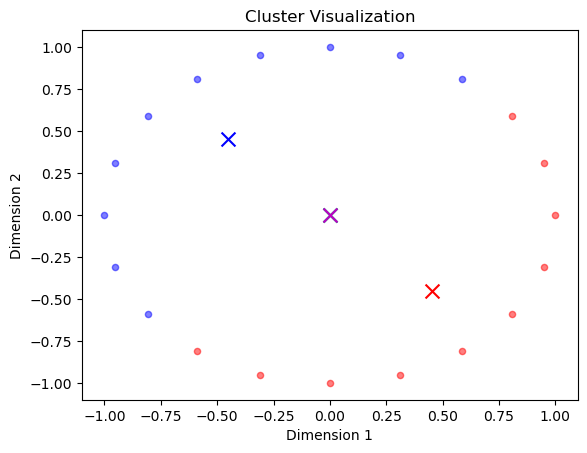

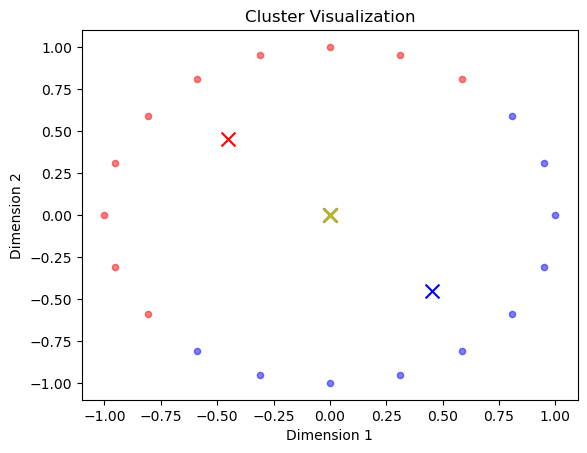

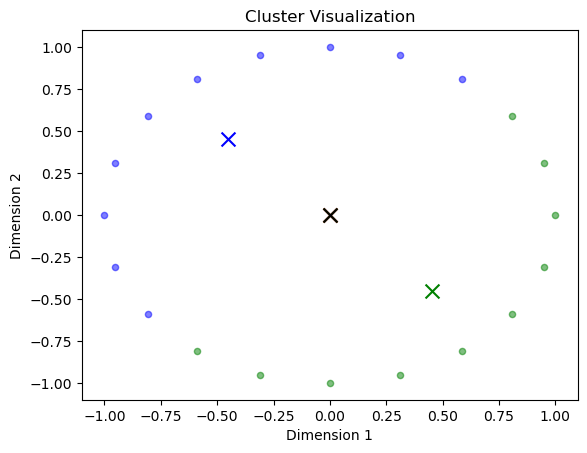

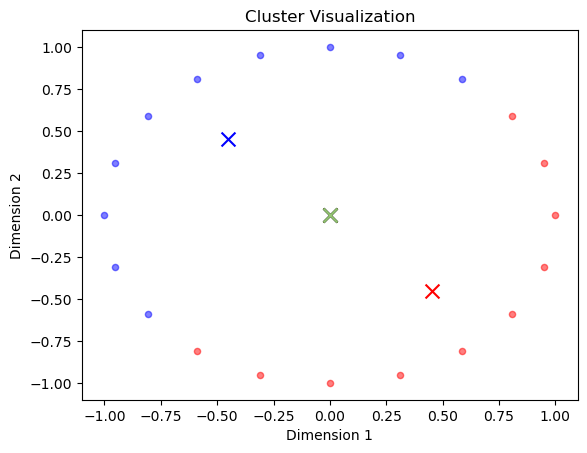

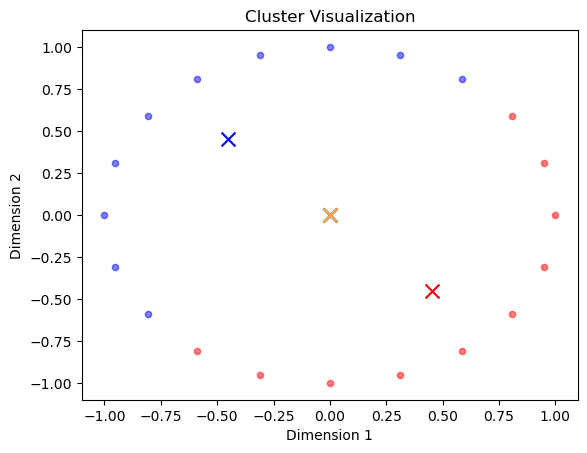

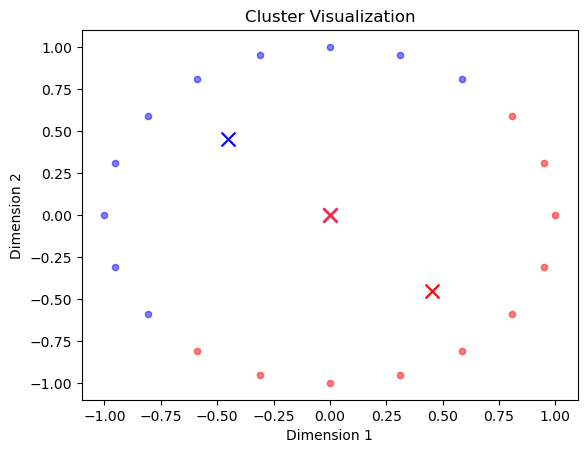

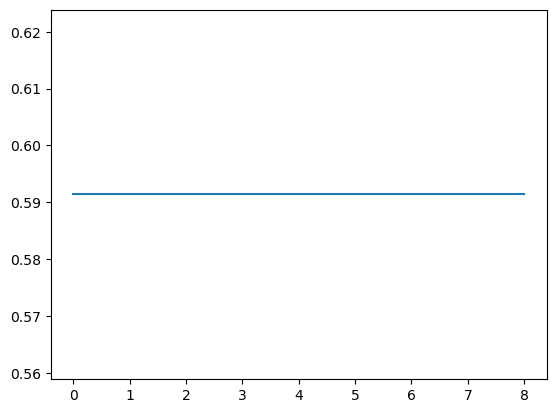

In [37]:
angle = np.linspace(0,2*np.pi,20, endpoint = False)
X = np.append([np.cos(angle)],[np.sin(angle)],0).transpose()
dist_func = []
for i in range(2, 11):
    y, z = GUC_Kmean(X, i, "Pearson")
    dist_func.append(z)
    plt.figure()
    display_cluster(X, km=y,num_clusters=i)
    
plt.figure()
plt.plot(dist_func)

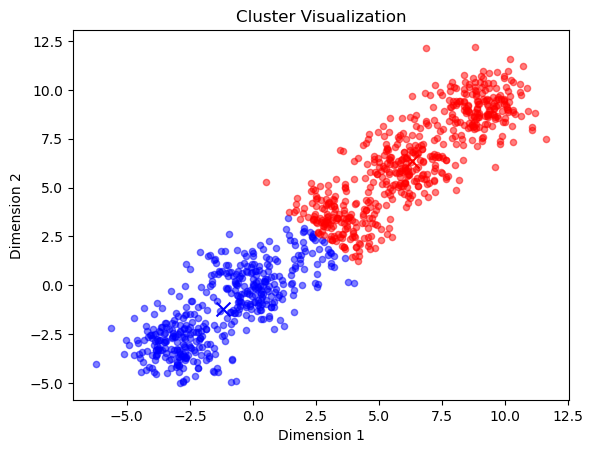

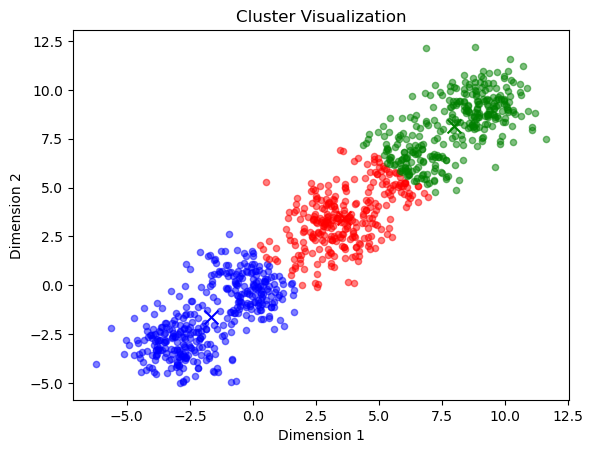

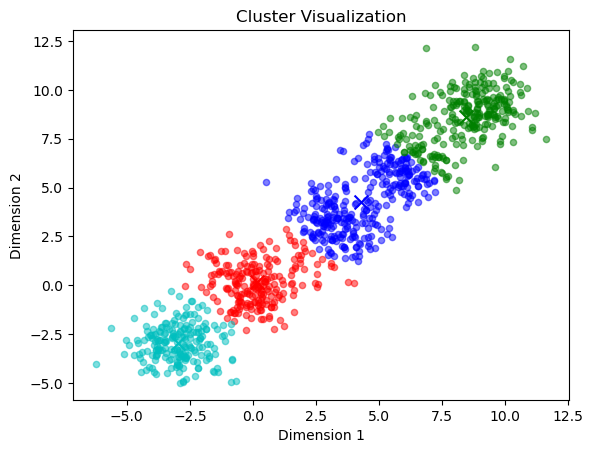

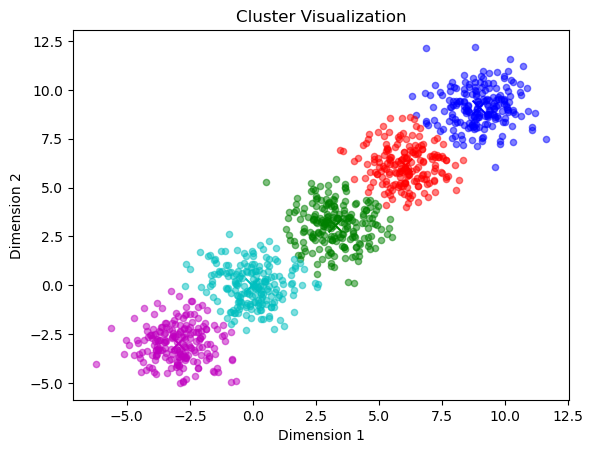

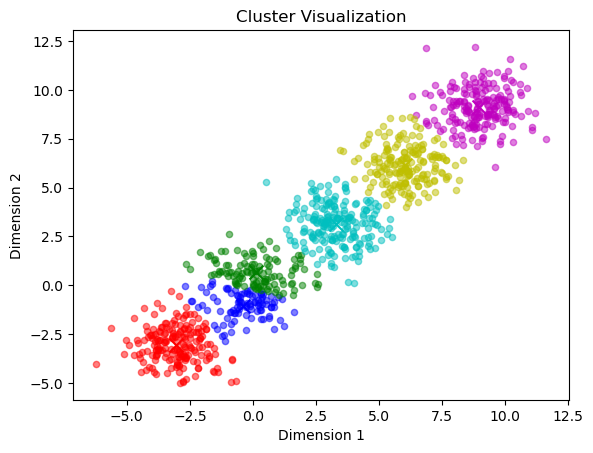

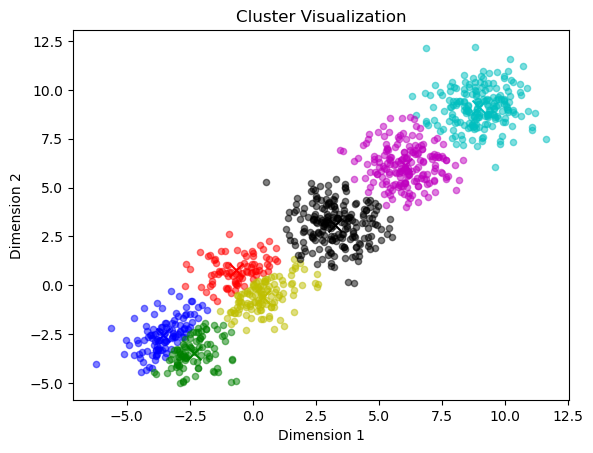

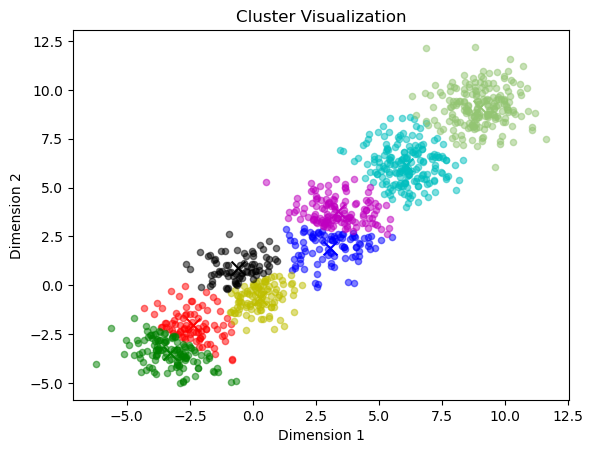

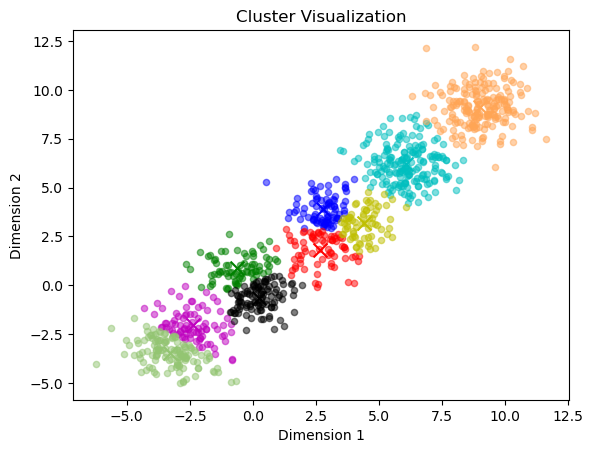

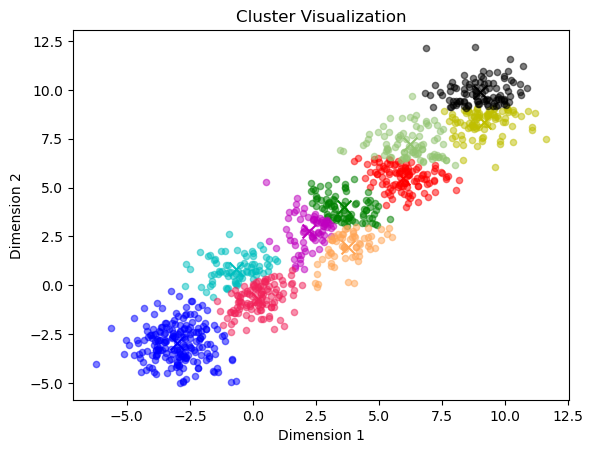

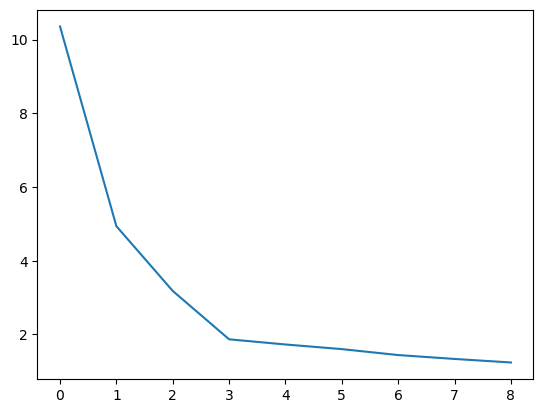

In [15]:
n_samples = 1000
n_bins = 4  
centers = [(-3, -3), (0, 0), (3, 3), (6, 6), (9,9)]
X, y = make_blobs(n_samples=n_samples, n_features=2, cluster_std=1.0,
                  centers=centers, shuffle=False, random_state=42)
dist_func = []
for i in range(2, 11):
    y, z = GUC_Kmean(X, i, "Euclidean")
    dist_func.append(z)
    plt.figure()
    display_cluster(X, km=y,num_clusters=i)
    
plt.figure()
plt.plot(dist_func)

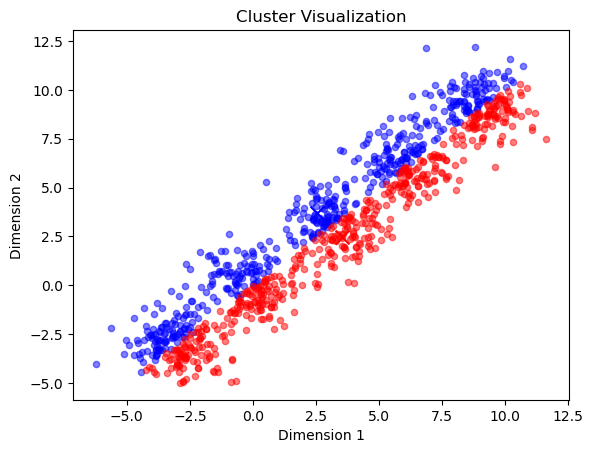

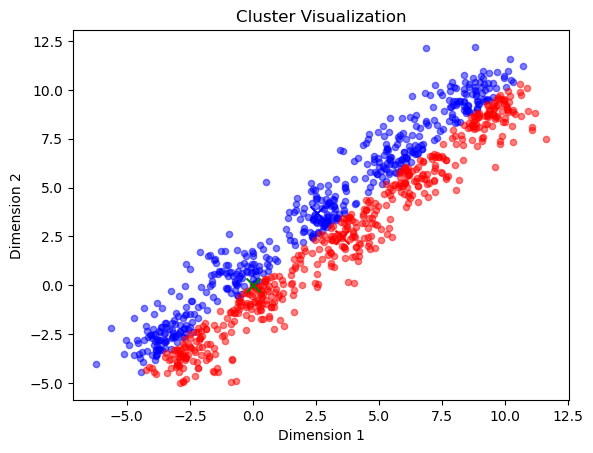

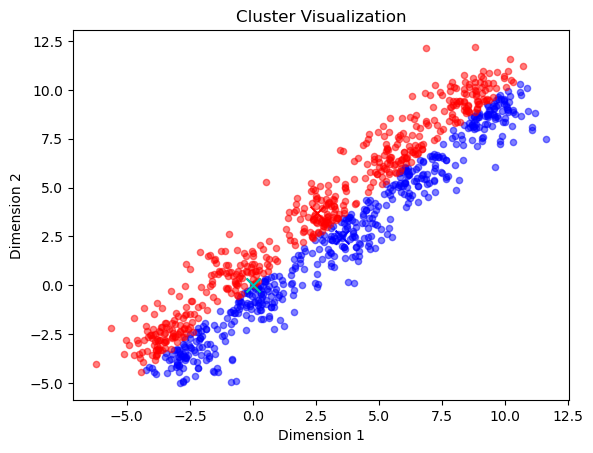

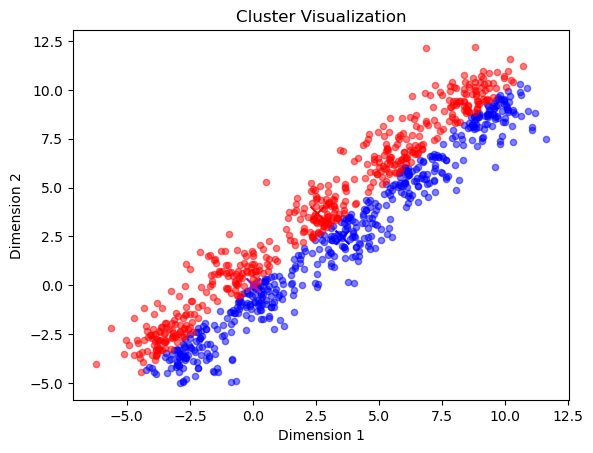

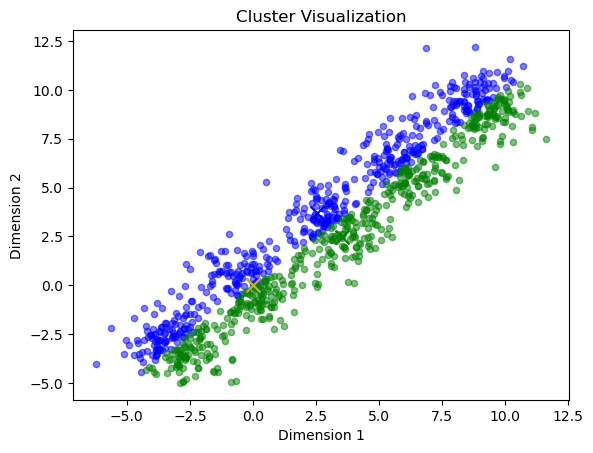

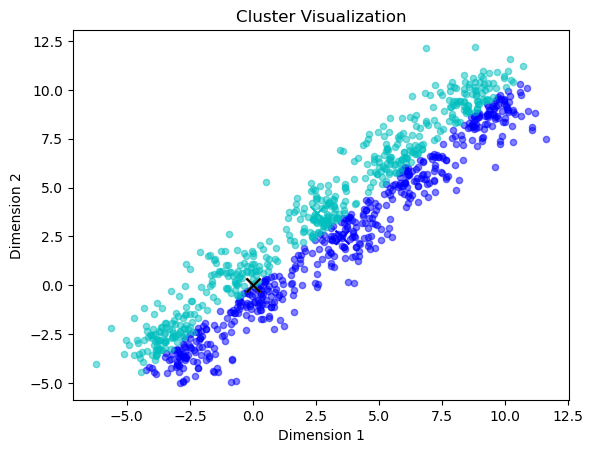

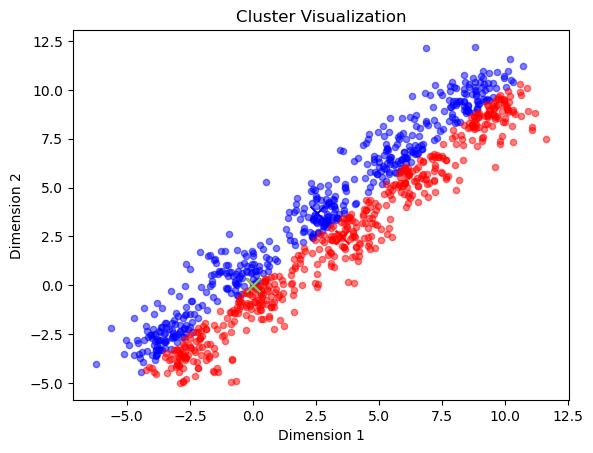

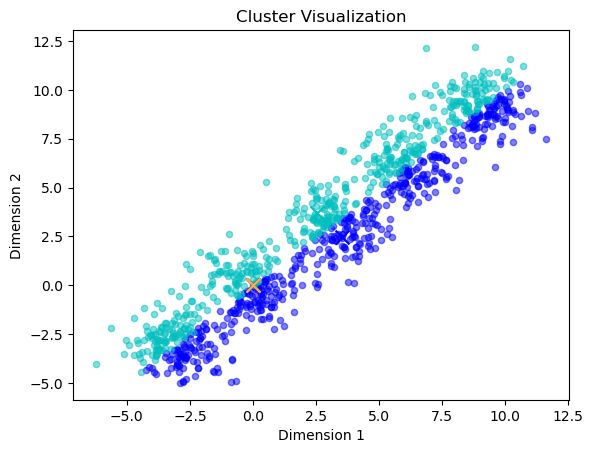

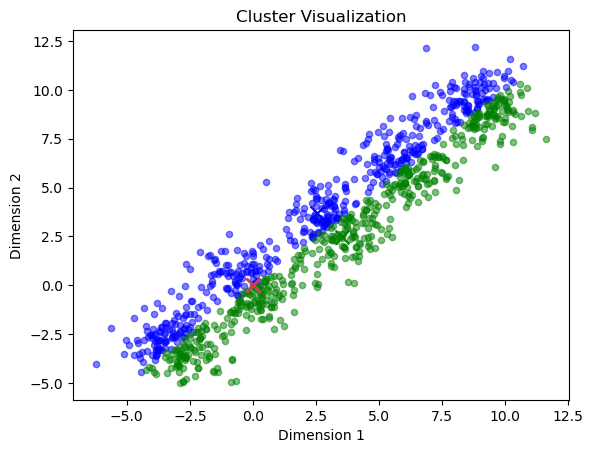

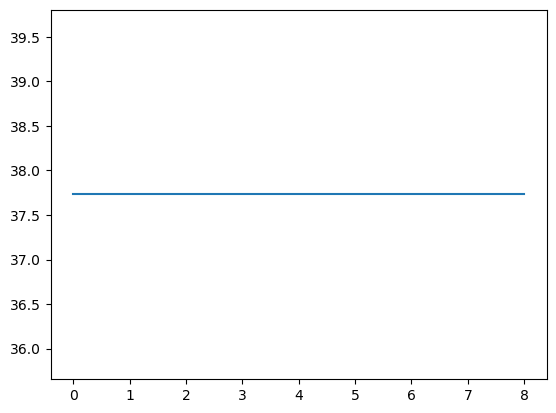

In [39]:
n_samples = 1000
n_bins = 4  
centers = [(-3, -3), (0, 0), (3, 3), (6, 6), (9,9)]
X, y = make_blobs(n_samples=n_samples, n_features=2, cluster_std=1.0,
                  centers=centers, shuffle=False, random_state=42)
dist_func = []
for i in range(2, 11):
    y, z = GUC_Kmean(X, i, "Pearson")
    dist_func.append(z)
    plt.figure()
    display_cluster(X, km=y,num_clusters=i)
    
plt.figure()
plt.plot(dist_func)

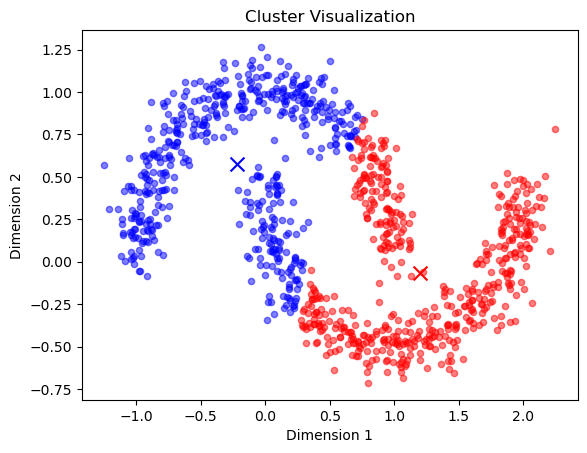

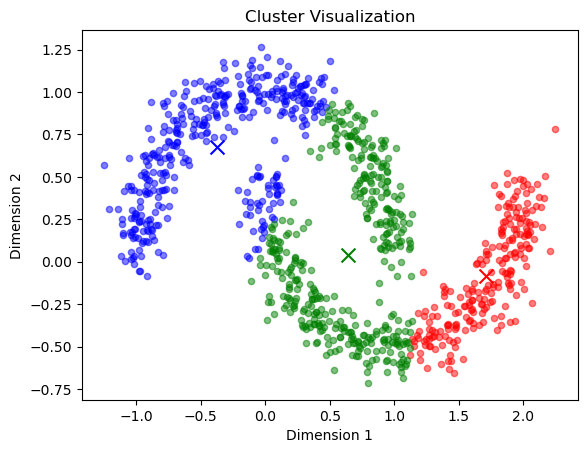

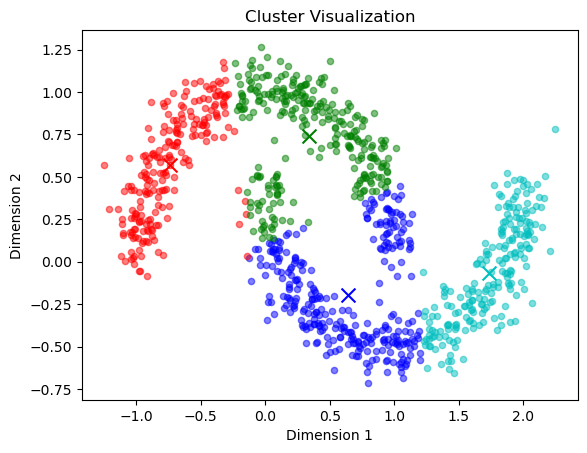

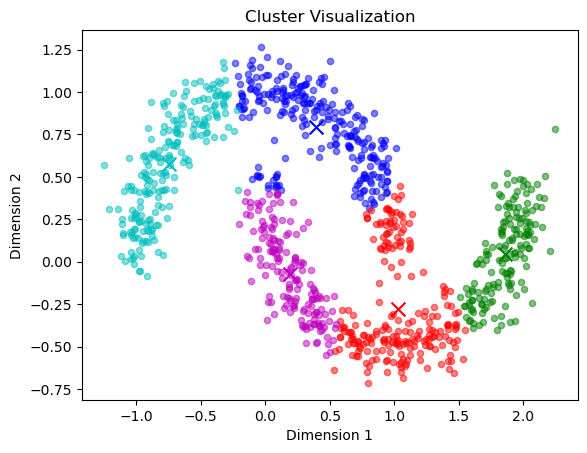

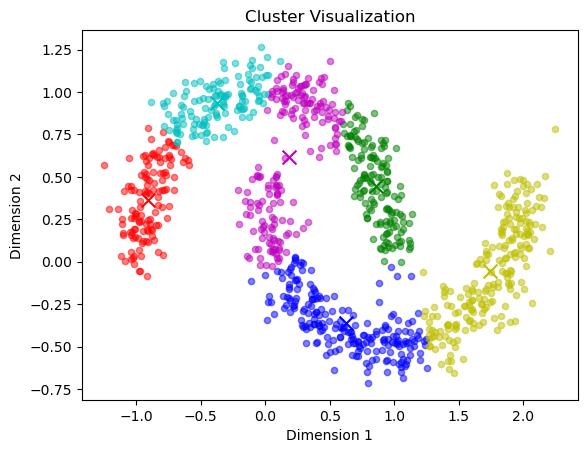

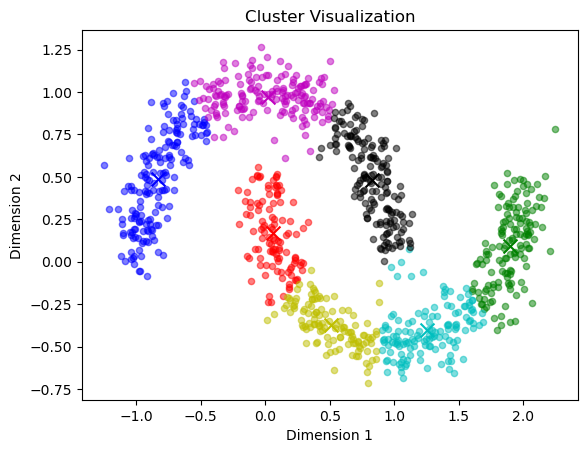

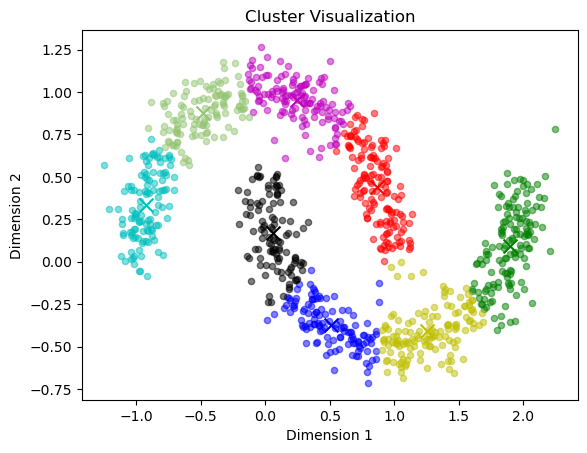

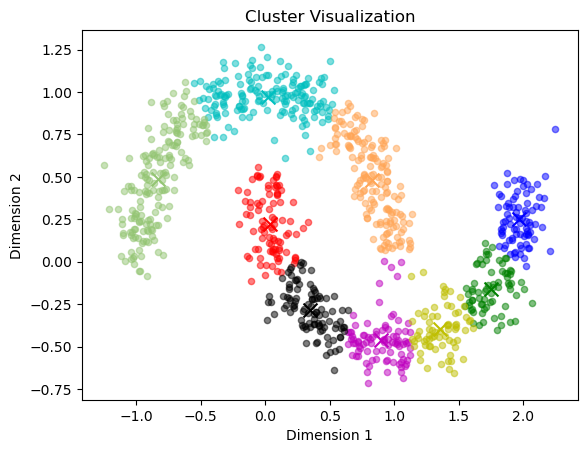

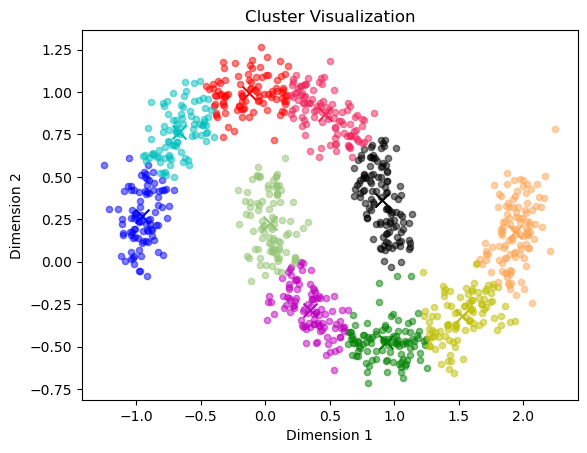

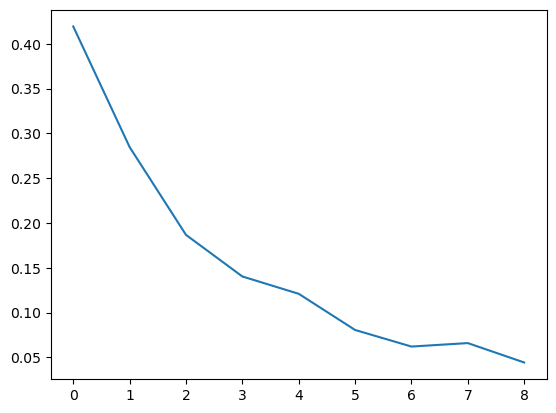

In [16]:
n_samples = 1000
X, y = noisy_moons = make_moons(n_samples=n_samples, noise= .1)

dist_func = []
for i in range(2, 11):
    y, z = GUC_Kmean(X, i, "Euclidean")
    dist_func.append(z)
    plt.figure()
    display_cluster(X, km=y,num_clusters=i)
    
plt.figure()
plt.plot(dist_func)

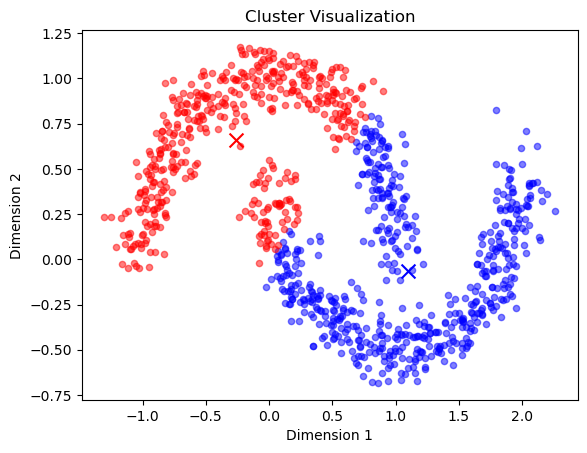

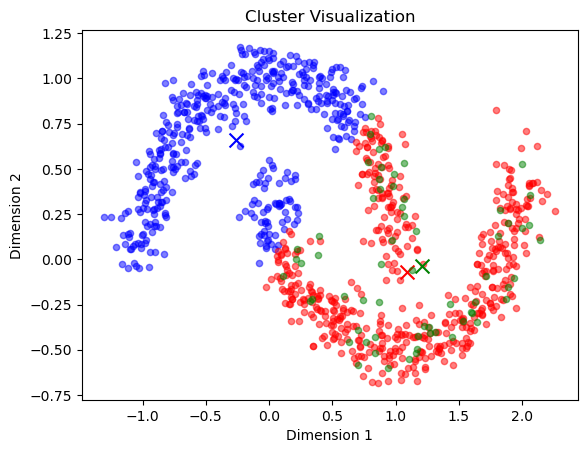

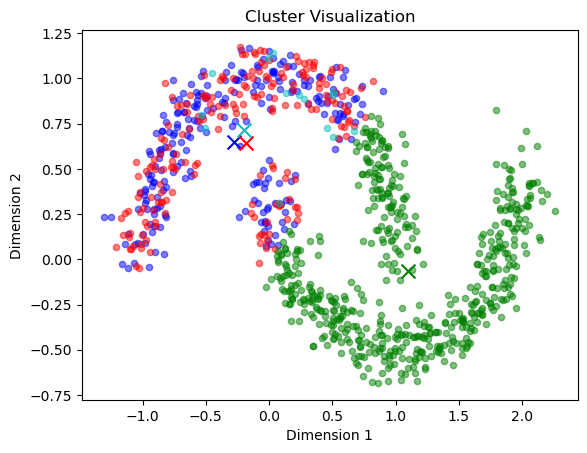

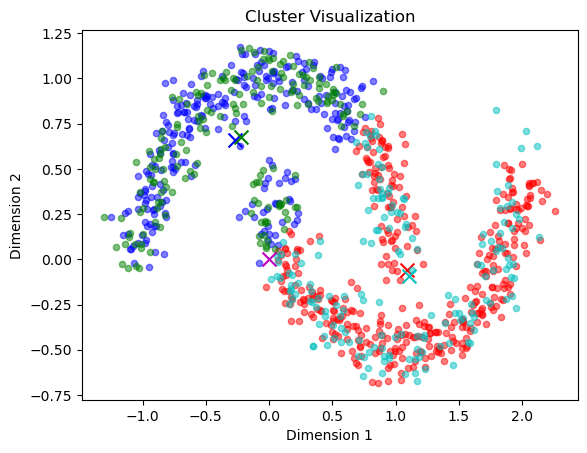

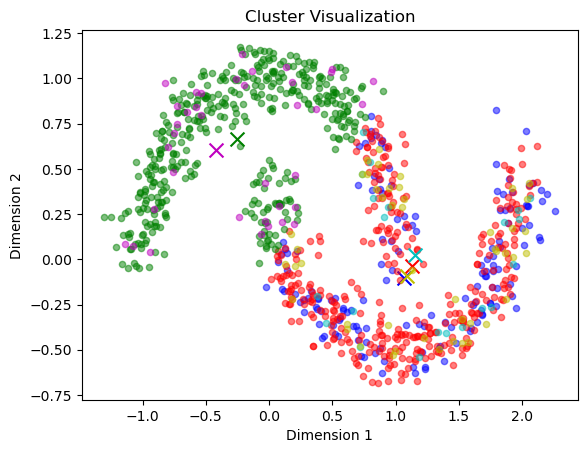

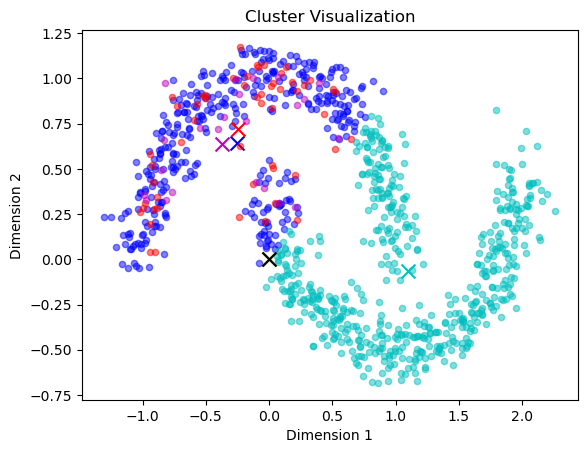

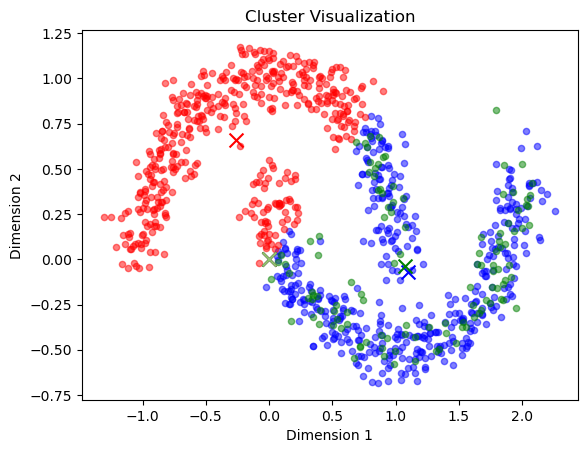

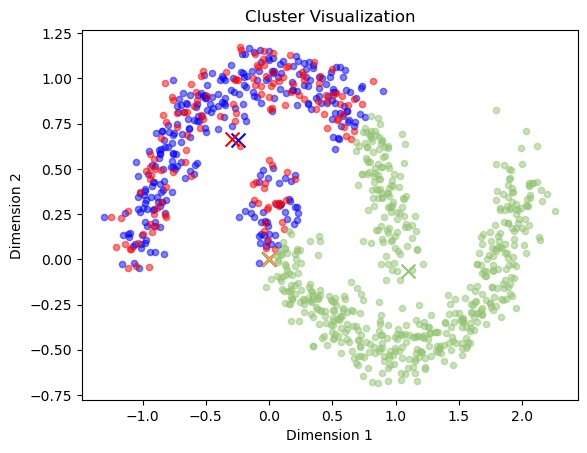

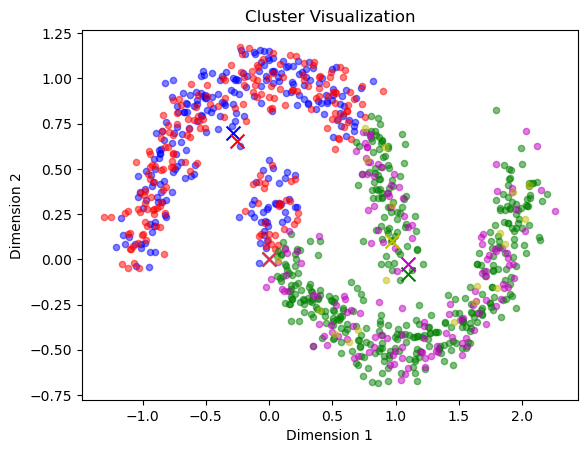

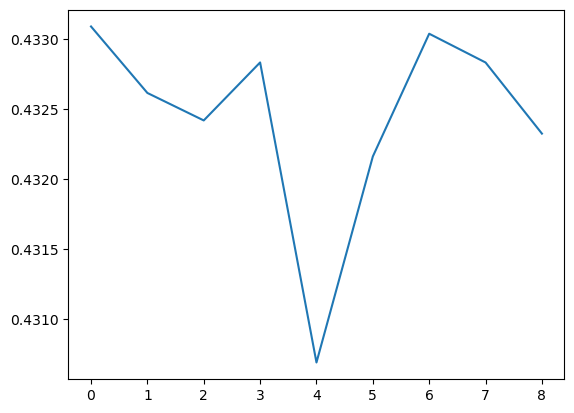

In [44]:
n_samples = 1000
X, y = noisy_moons = make_moons(n_samples=n_samples, noise= .1)

dist_func = []
for i in range(2, 11):
    y, z = GUC_Kmean(X, i, "Pearson")
    dist_func.append(z)
    plt.figure()
    display_cluster(X, km=y,num_clusters=i)
    
plt.figure()
plt.plot(dist_func)

## 4. Using the GUC_Kmean function to segment customers int he provided customer dataset
1. Apply the GUC_Kmean fucntion to customer data  
2. Try a varing number of cluster that range from 2 to 10 cluster on each set 
3. Display your results.
4. plot the Cluster Metric versus the number of clusters
4. Change the distance function and repeat the above steps 

In [17]:
df = pd.read_csv(r'C:\Users\Lenovo\Desktop\Ibrahim\ML\Customer_data.csv')

data = df.to_numpy()

<Figure size 640x480 with 0 Axes>

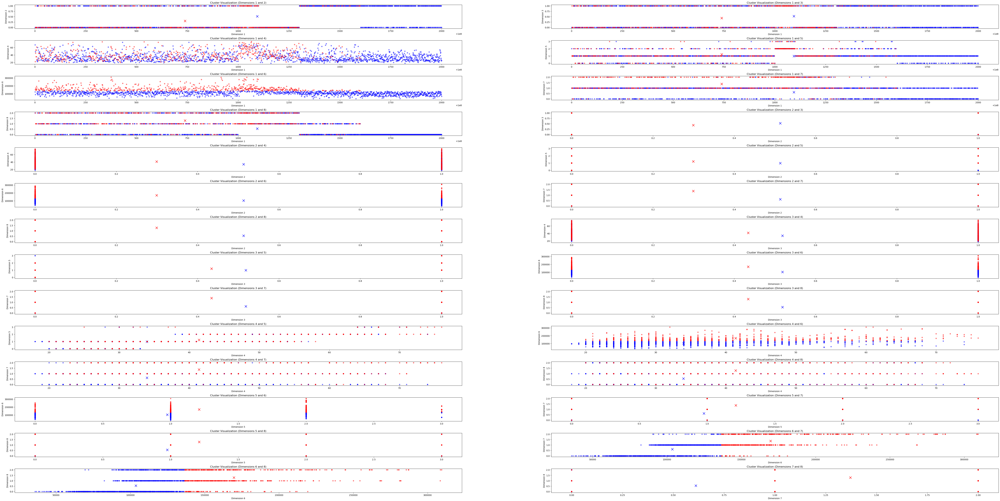

<Figure size 640x480 with 0 Axes>

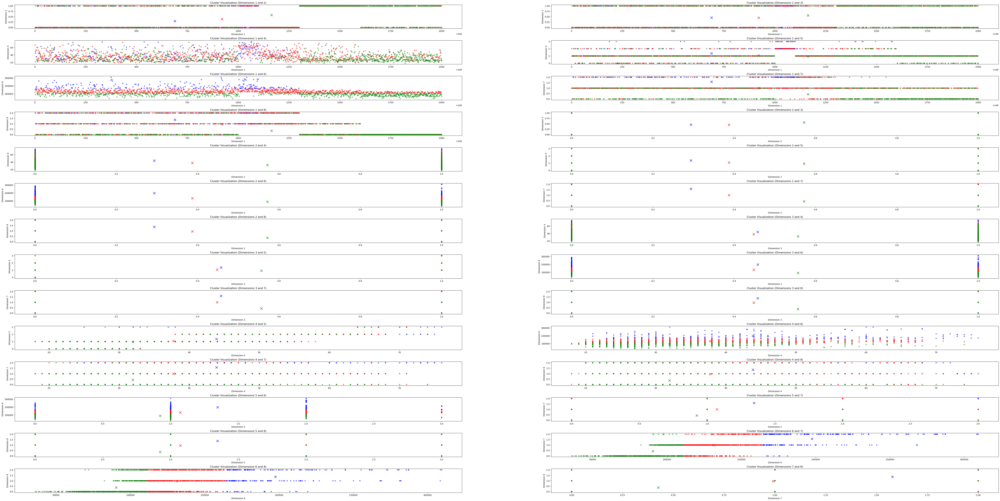

<Figure size 640x480 with 0 Axes>

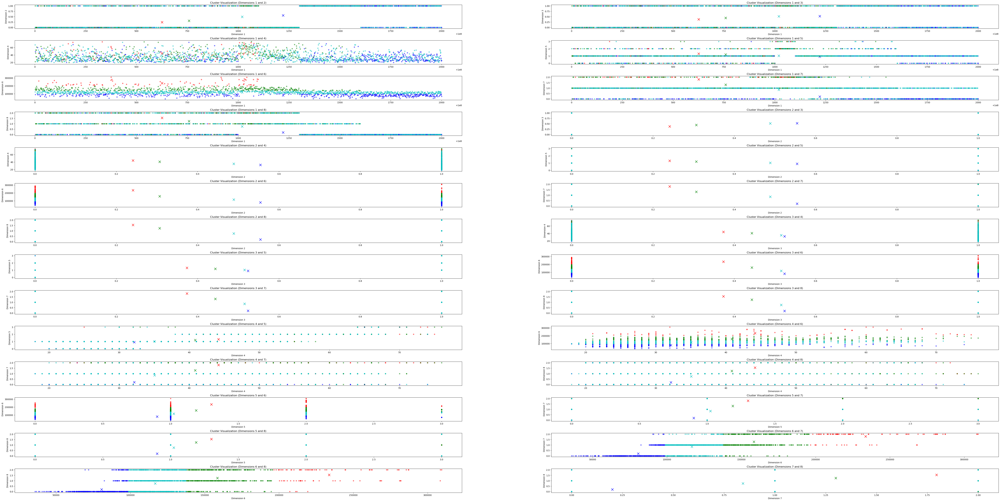

<Figure size 640x480 with 0 Axes>

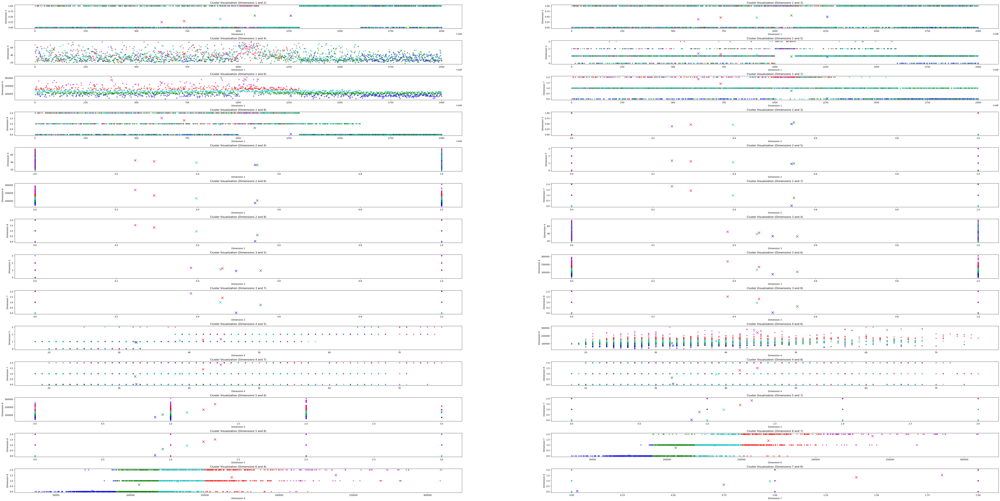

<Figure size 640x480 with 0 Axes>

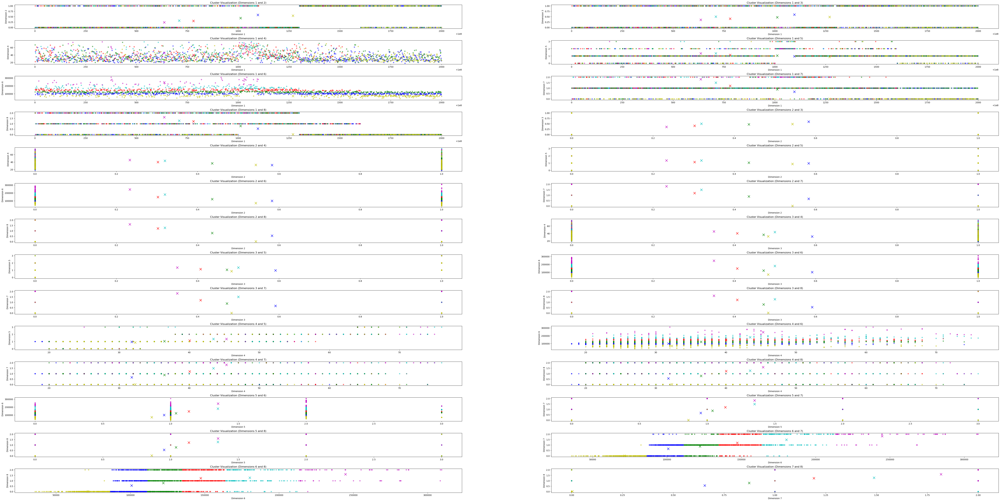

<Figure size 640x480 with 0 Axes>

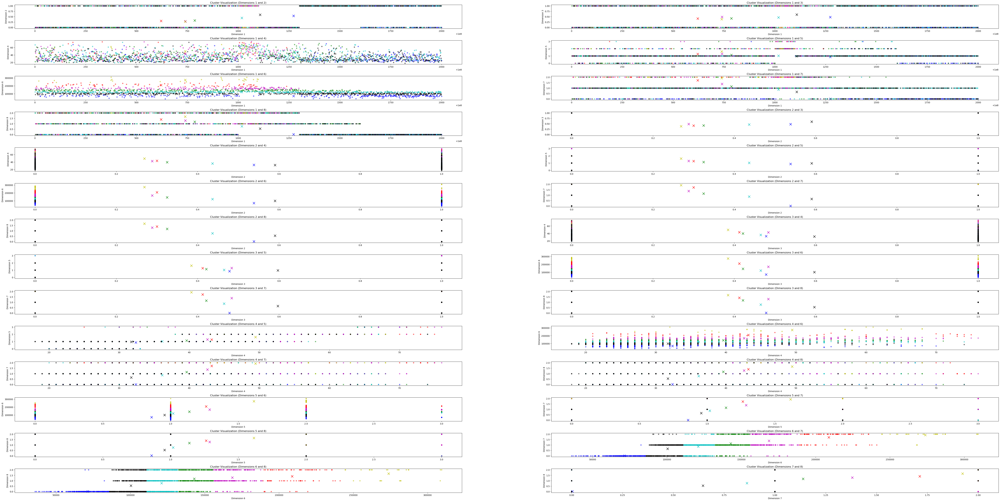

<Figure size 640x480 with 0 Axes>

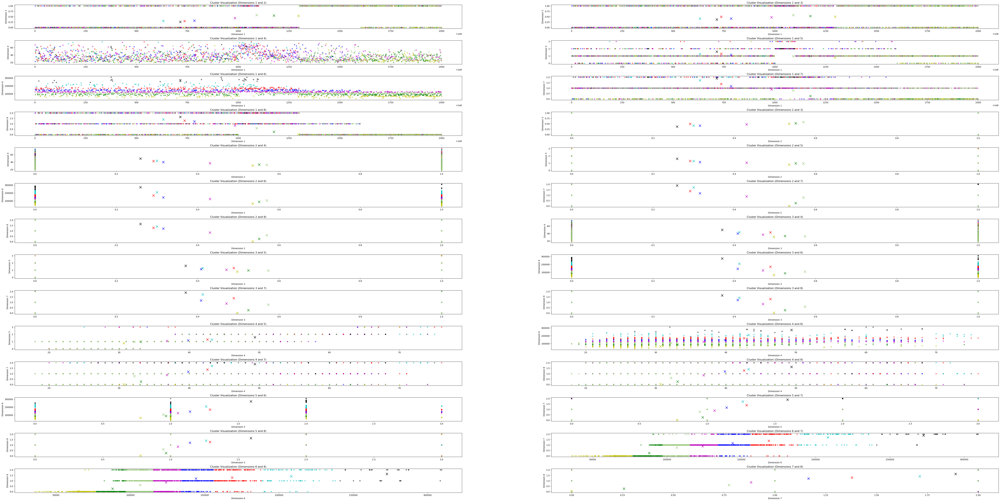

<Figure size 640x480 with 0 Axes>

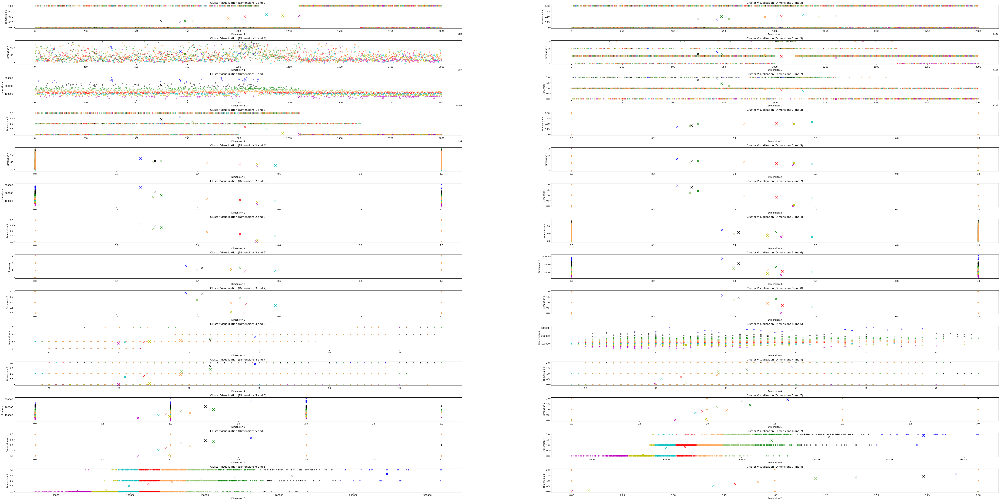

<Figure size 640x480 with 0 Axes>

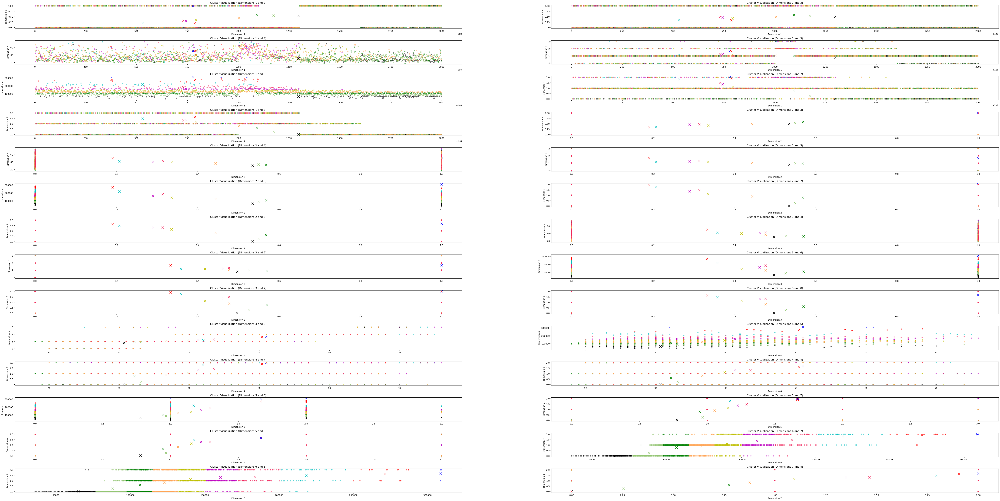

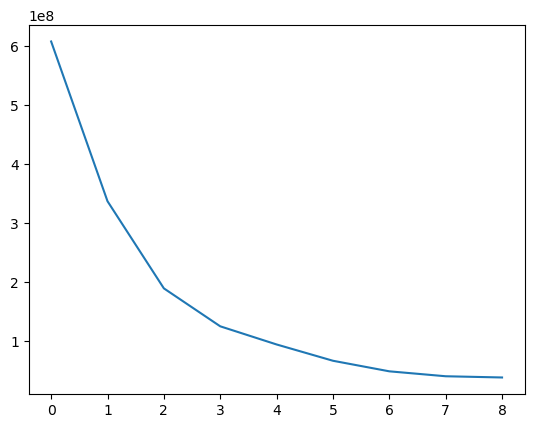

In [20]:
dist_func = []
for i in range(2, 11):
    y, z = GUC_Kmean(data, i, "Euclidean")
    dist_func.append(z)
    plt.figure()
    display_cluster(data, km=y,num_clusters=i)
    
plt.figure()
plt.plot(dist_func)

<Figure size 640x480 with 0 Axes>

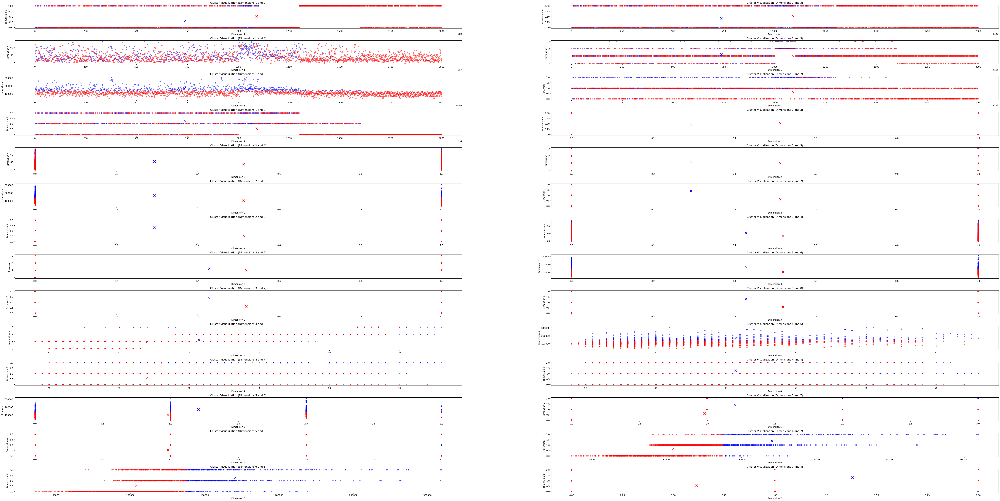

<Figure size 640x480 with 0 Axes>

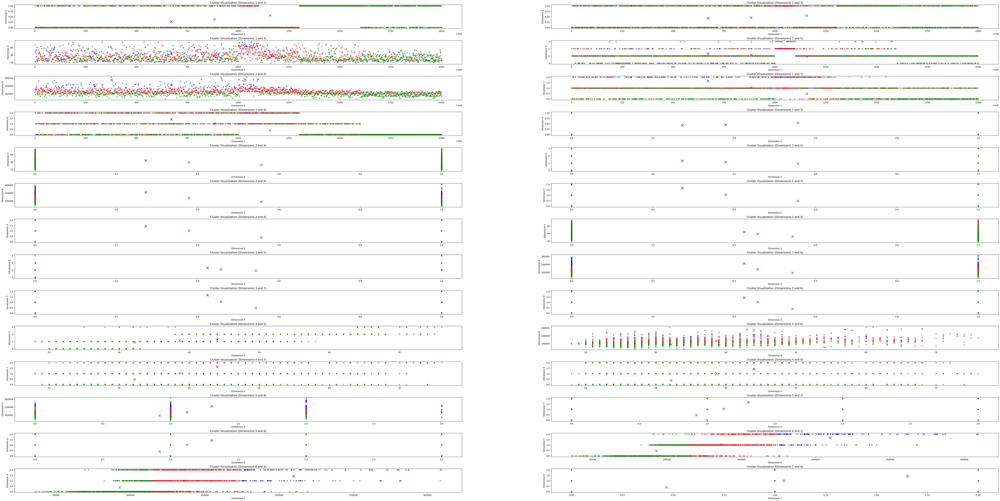

<Figure size 640x480 with 0 Axes>

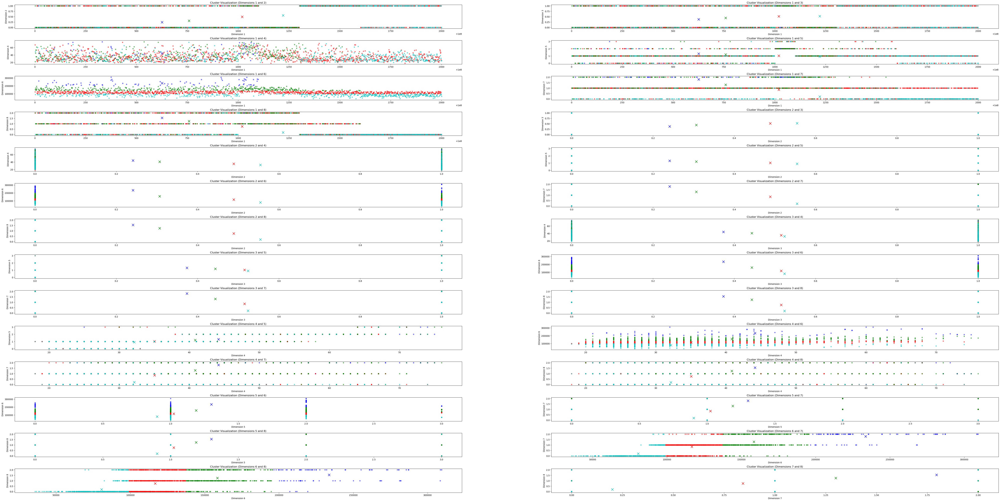

<Figure size 640x480 with 0 Axes>

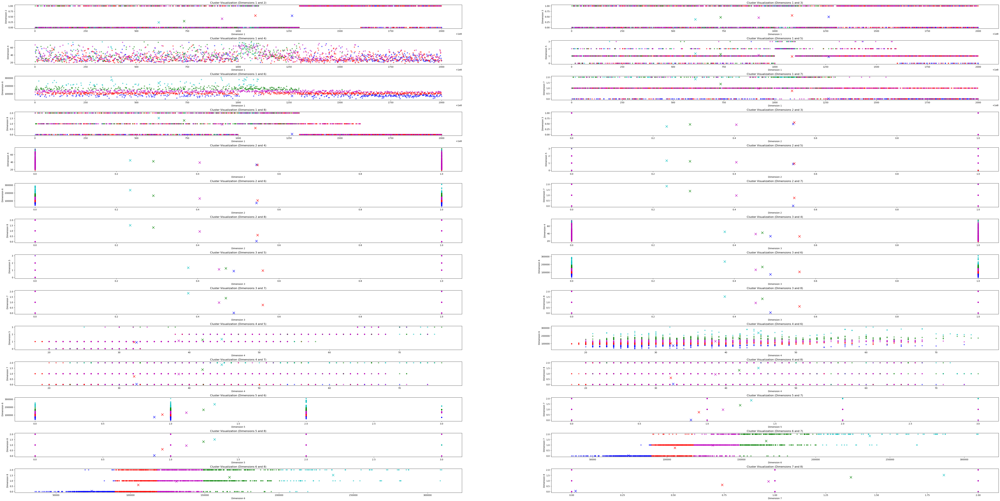

<Figure size 640x480 with 0 Axes>

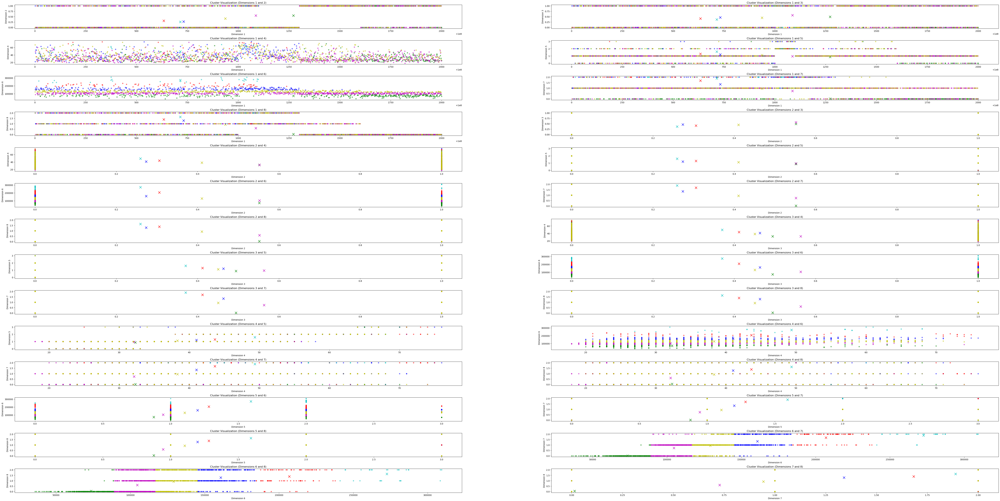

<Figure size 640x480 with 0 Axes>

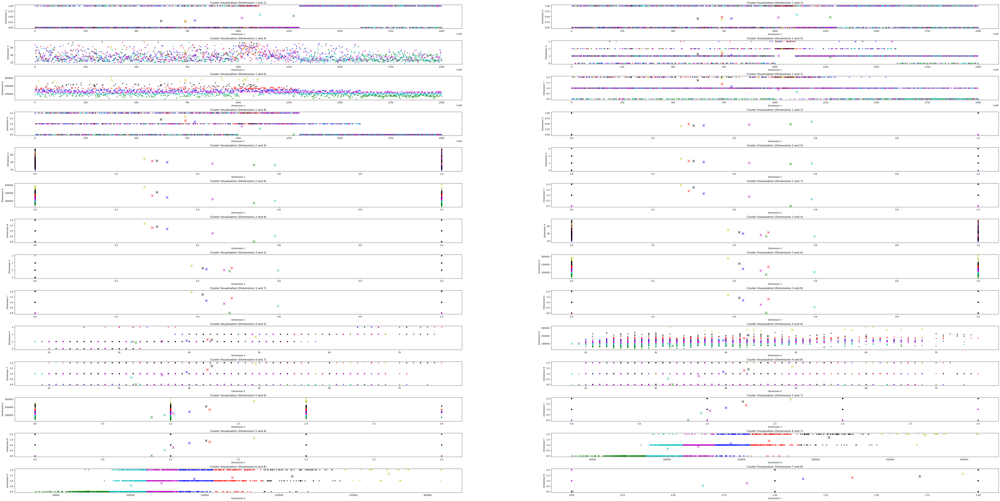

<Figure size 640x480 with 0 Axes>

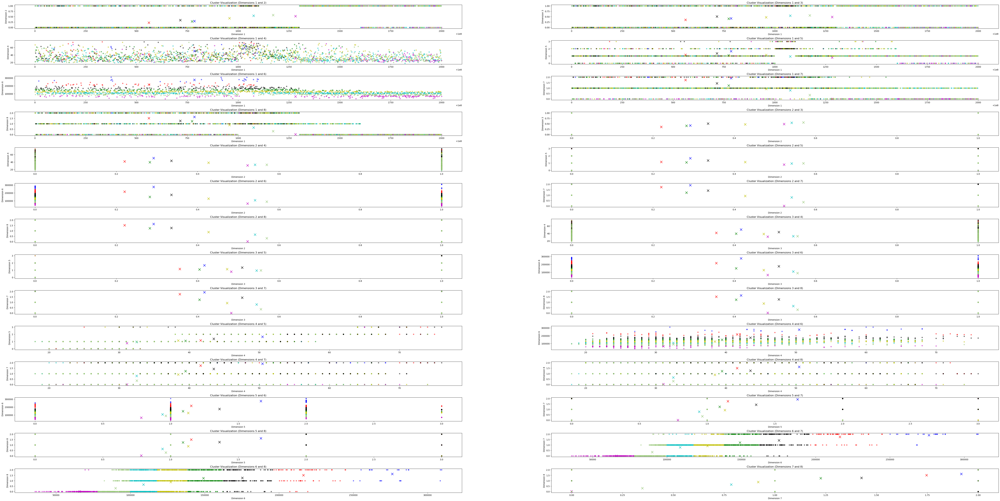

<Figure size 640x480 with 0 Axes>

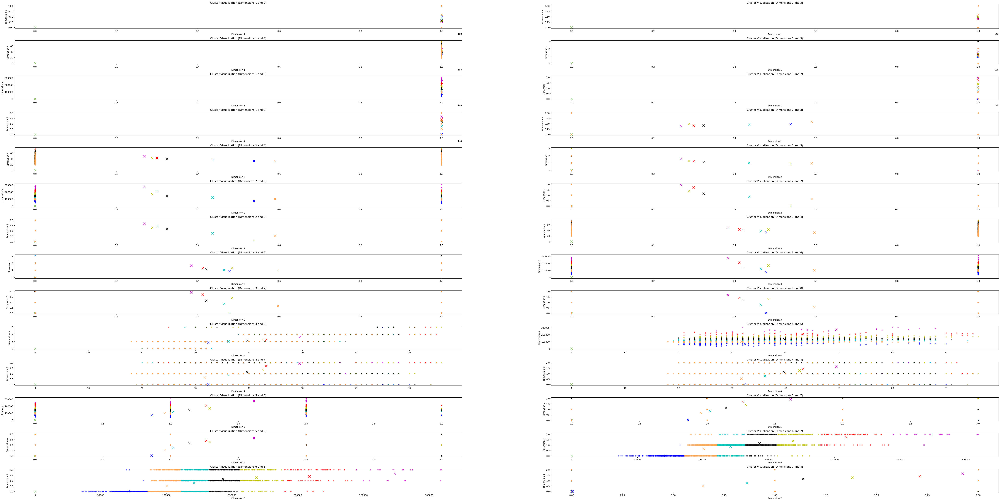

<Figure size 640x480 with 0 Axes>

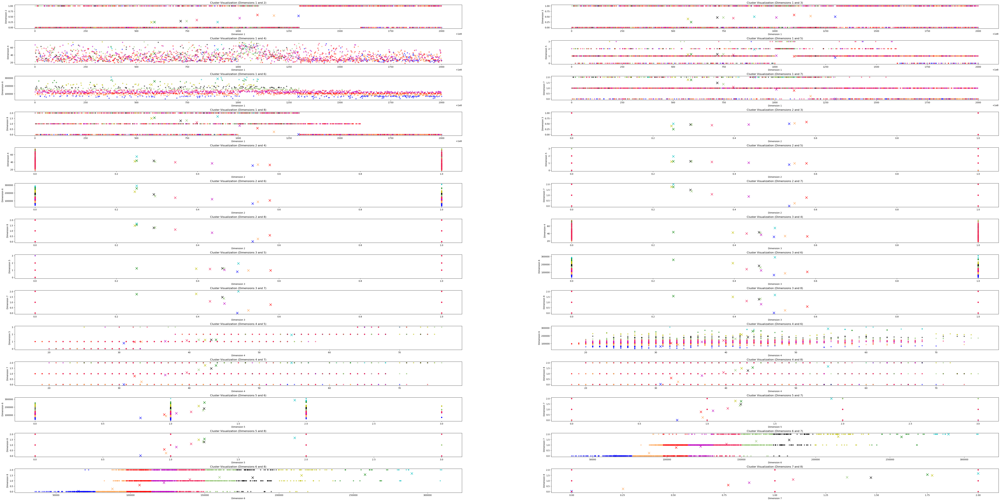

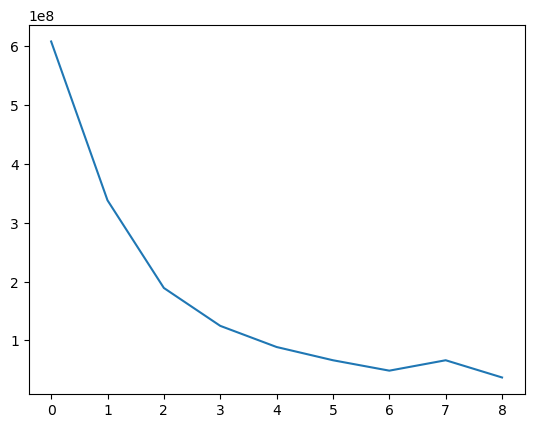

In [45]:
dist_func = []
for i in range(2, 11):
    y, z = GUC_Kmean(data, i, "Pearson")
    dist_func.append(z)
    plt.figure()
    display_cluster(data, km=y,num_clusters=i)
    
plt.figure()
plt.plot(dist_func)